## Get the Data

Either use the provided .csv file or (optionally) get fresh (the freshest?) data from running an SQL query on StackExchange: 

Follow this link to run the query from [StackExchange](https://data.stackexchange.com/stackoverflow/query/675441/popular-programming-languages-per-over-time-eversql-com) to get your own .csv file

<code>
select dateadd(month, datediff(month, 0, q.CreationDate), 0) m, TagName, count(*)
from PostTags pt
join Posts q on q.Id=pt.PostId
join Tags t on t.Id=pt.TagId
where TagName in ('java','c','c++','python','c#','javascript','assembly','php','perl','ruby','visual basic','swift','r','object-c','scratch','go','swift','delphi')
and q.CreationDate < dateadd(month, datediff(month, 0, getdate()), 0)
group by dateadd(month, datediff(month, 0, q.CreationDate), 0), TagName
order by dateadd(month, datediff(month, 0, q.CreationDate), 0)
</code>

## Import Statements

In [86]:
import pandas as pd
import matplotlib.pyplot as plt

## Data Exploration

**Challenge**: Read the .csv file and store it in a Pandas dataframe

In [60]:
data = pd.read_csv("QueryResults.csv", names=["Dates", "Tags", "Posts"],header=0, parse_dates=["Dates"])
data = data.dropna()

**Challenge**: Examine the first 5 rows and the last 5 rows of the of the dataframe

In [61]:
print(data.head())
print(data.tail())

       Dates      Tags  Posts
0 2008-07-01        c#      3
1 2008-08-01  assembly      8
2 2008-08-01         c     82
3 2008-08-01        c#    503
4 2008-08-01       c++    164
          Dates    Tags  Posts
2784 2025-04-01     php    283
2785 2025-04-01  python   1865
2786 2025-04-01       r    415
2787 2025-04-01    ruby     33
2788 2025-04-01   swift    231


**Challenge:** Check how many rows and how many columns there are. 
What are the dimensions of the dataframe?

In [62]:
print(data.shape)
print(data.columns)

(2789, 3)
Index(['Dates', 'Tags', 'Posts'], dtype='object')


**Challenge**: Count the number of entries in each column of the dataframe

In [63]:
print(data.count())

Dates    2789
Tags     2789
Posts    2789
dtype: int64


**Challenge**: Calculate the total number of post per language.
Which Programming language has had the highest total number of posts of all time?

In [73]:
print(data.groupby("Tags")["Posts"].sum())
print()
print(data["Posts"].max()," ",data["Tags"][data["Posts"].idxmax()])

Tags
assembly        45074
c              407737
c#            1624580
c++            814082
delphi          52466
go              74371
java          1919524
javascript    2530525
perl            68329
php           1467272
python        2210724
r              510764
ruby           229339
swift          336364
Name: Posts, dtype: int64

29317   python


Some languages are older (e.g., C) and other languages are newer (e.g., Swift). The dataset starts in September 2008.

**Challenge**: How many months of data exist per language? Which language had the fewest months with an entry? 


In [74]:
print(data.groupby("Tags").count())

            Dates  Posts
Tags                    
assembly      201    201
c             201    201
c#            202    202
c++           201    201
delphi        201    201
go            186    186
java          201    201
javascript    201    201
perl          201    201
php           201    201
python        201    201
r             199    199
ruby          201    201
swift         192    192


## Data Manipulation



In [75]:
reshaped_data = data.pivot(index="Dates", columns="Tags", values="Posts")
reshaped_data = reshaped_data.fillna(0)
print(reshaped_data)

Tags        assembly      c      c#    c++  delphi     go    java  javascript  \
Dates                                                                           
2008-07-01       0.0    0.0     3.0    0.0     0.0    0.0     0.0         0.0   
2008-08-01       8.0   82.0   503.0  164.0    13.0    0.0   220.0       160.0   
2008-09-01      28.0  320.0  1638.0  753.0   104.0    0.0  1122.0       630.0   
2008-10-01      16.0  303.0  1983.0  805.0   112.0    0.0  1145.0       720.0   
2008-11-01      16.0  258.0  1729.0  733.0   139.0    0.0   953.0       581.0   
...              ...    ...     ...    ...     ...    ...     ...         ...   
2024-12-01      90.0  325.0  1084.0  685.0    42.0  115.0  1162.0      1376.0   
2025-01-01      68.0  321.0  1130.0  688.0    56.0  134.0  1158.0      1417.0   
2025-02-01      61.0  278.0   994.0  582.0    59.0   96.0   933.0      1151.0   
2025-03-01      60.0  308.0   915.0  680.0    53.0   97.0   896.0      1127.0   
2025-04-01      53.0  214.0 

**Challenge**: What are the dimensions of our new dataframe? How many rows and columns does it have? Print out the column names and print out the first 5 rows of the dataframe.

In [77]:
print(reshaped_data.shape)


(202, 14)


In [78]:
print(reshaped_data.columns)

Index(['assembly', 'c', 'c#', 'c++', 'delphi', 'go', 'java', 'javascript',
       'perl', 'php', 'python', 'r', 'ruby', 'swift'],
      dtype='object', name='Tags')


In [81]:
print(reshaped_data.head())
print()
print(reshaped_data.tail())

Tags        assembly      c      c#    c++  delphi   go    java  javascript  \
Dates                                                                         
2008-07-01       0.0    0.0     3.0    0.0     0.0  0.0     0.0         0.0   
2008-08-01       8.0   82.0   503.0  164.0    13.0  0.0   220.0       160.0   
2008-09-01      28.0  320.0  1638.0  753.0   104.0  0.0  1122.0       630.0   
2008-10-01      16.0  303.0  1983.0  805.0   112.0  0.0  1145.0       720.0   
2008-11-01      16.0  258.0  1729.0  733.0   139.0  0.0   953.0       581.0   

Tags         perl    php  python    r   ruby  swift  
Dates                                                
2008-07-01    0.0    0.0     0.0  0.0    0.0    0.0  
2008-08-01   28.0  157.0   119.0  0.0   68.0    0.0  
2008-09-01  129.0  473.0   534.0  6.0  285.0    0.0  
2008-10-01  128.0  602.0   504.0  0.0  246.0    0.0  
2008-11-01   97.0  497.0   447.0  1.0  154.0    0.0  

Tags        assembly      c      c#    c++  delphi     go    java  

**Challenge**: Count the number of entries per programming language. Why might the number of entries be different? 

In [83]:
print(reshaped_data.count())

Tags
assembly      202
c             202
c#            202
c++           202
delphi        202
go            202
java          202
javascript    202
perl          202
php           202
python        202
r             202
ruby          202
swift         202
dtype: int64


In [84]:
print(reshaped_data.sum())

Tags
assembly        45074.0
c              407737.0
c#            1624580.0
c++            814082.0
delphi          52466.0
go              74371.0
java          1919524.0
javascript    2530525.0
perl            68329.0
php           1467272.0
python        2210724.0
r              510764.0
ruby           229339.0
swift          336364.0
dtype: float64


In [85]:
reshaped_data.isna().values.any()

False

## Data Visualisaton with with Matplotlib


**Challenge**: Use the [matplotlib documentation](https://matplotlib.org/3.2.1/api/_as_gen/matplotlib.pyplot.plot.html#matplotlib.pyplot.plot) to plot a single programming language (e.g., java) on a chart.

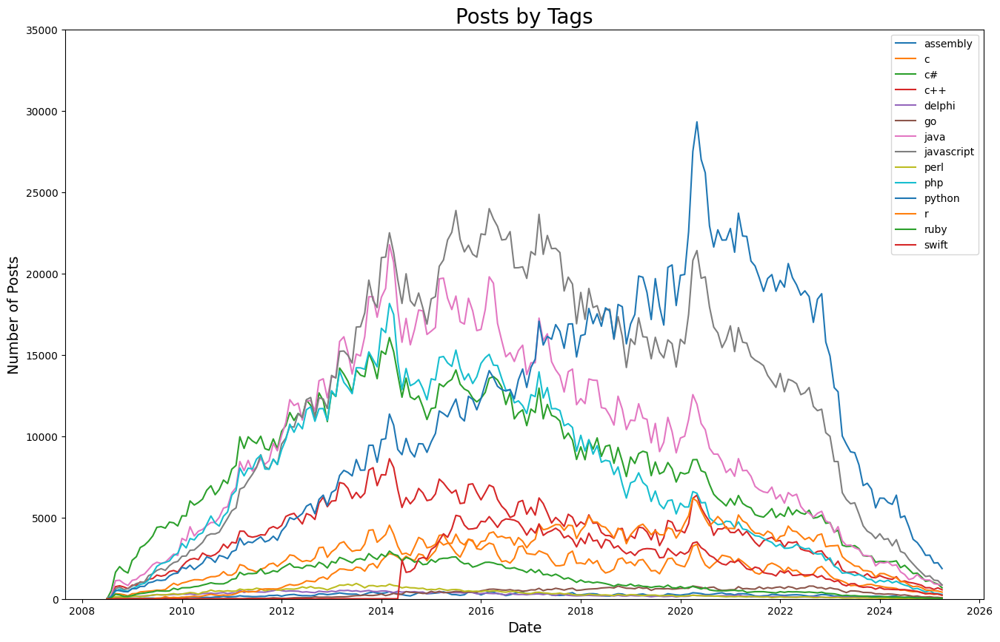

In [102]:
plt.figure(figsize=(16,10)) 
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)
# plt.plot(reshaped_data.index, reshaped_data["java"], label="Java")
plt.title("Posts by Tags", fontsize=20)

# plt.plot(reshaped_data.index, reshaped_data["python"], label="Python", color="red")
# plt.plot(reshaped_data.index, reshaped_data["javascript"], label="JavaScript", color="green")
# plt.plot(reshaped_data.index, reshaped_data["c#"], label="C#", color="orange")
# plt.plot(reshaped_data.index, reshaped_data["c++"], label="C++", color="purple")
# plt.plot(reshaped_data.index, reshaped_data["php"], label="PHP", color="pink")

leg_list = []
for column in reshaped_data.columns:
    plt.plot(reshaped_data.index, reshaped_data[column])
    leg_list.append(column)
plt.legend(leg_list)


# Smoothing out Time Series Data

Time series data can be quite noisy, with a lot of up and down spikes. To better see a trend we can plot an average of, say 6 or 12 observations. This is called the rolling mean. We calculate the average in a window of time and move it forward by one overservation. Pandas has two handy methods already built in to work this out: [rolling()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html) and [mean()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.core.window.rolling.Rolling.mean.html). 

In [103]:
roll_df = reshaped_data.rolling(window=6).mean()

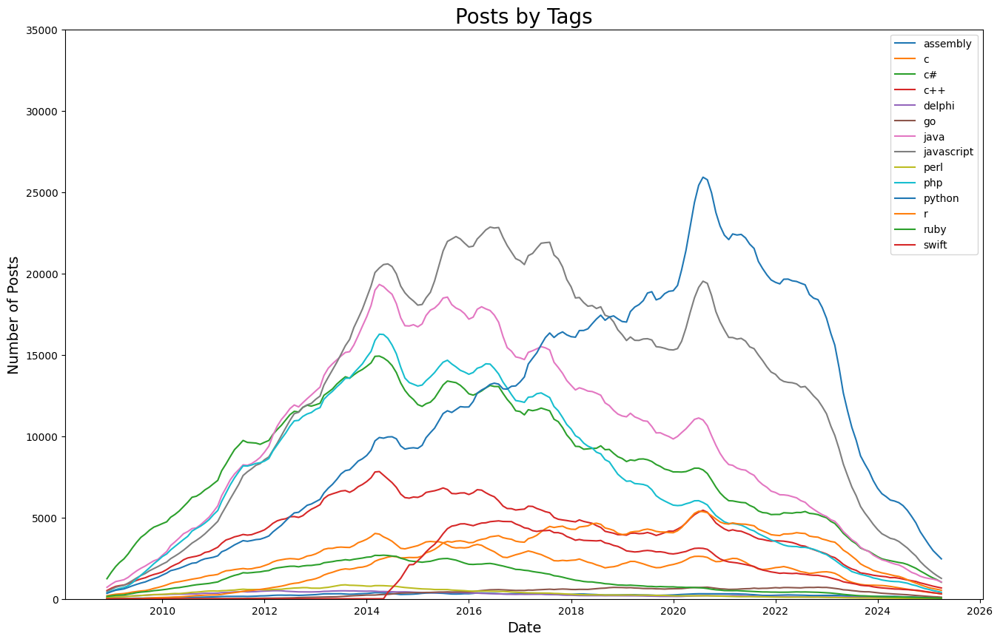

In [105]:
plt.figure(figsize=(16,10)) 
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)
plt.title("Posts by Tags", fontsize=20)
leg_list = []
for column in roll_df.columns:
    plt.plot(roll_df.index, roll_df[column])
    leg_list.append(column)
plt.legend(leg_list)


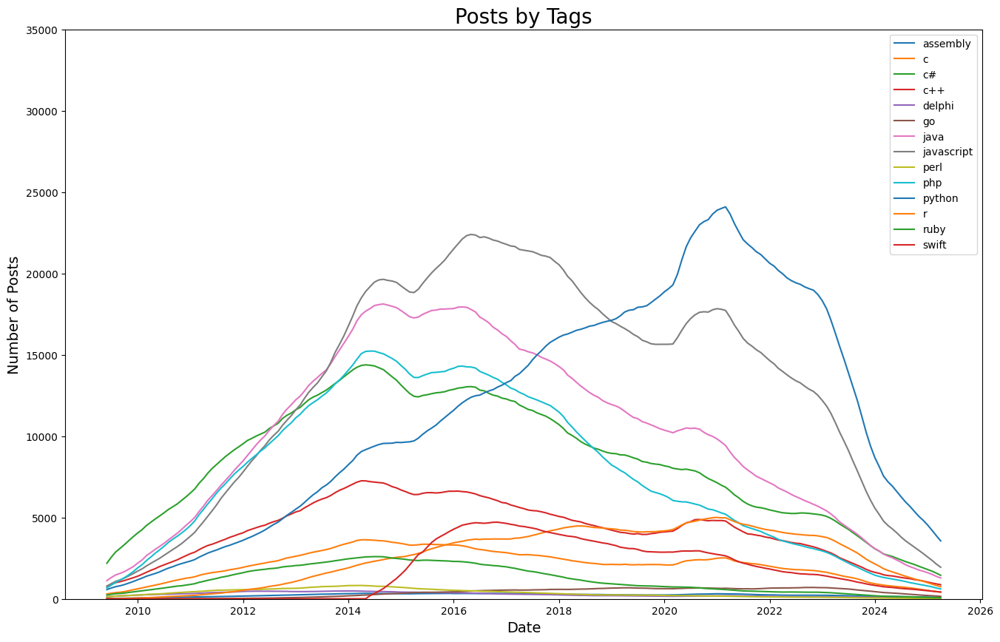

In [107]:
roll_df = reshaped_data.rolling(window=12).mean()
plt.figure(figsize=(16,10)) 
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)
plt.title("Posts by Tags", fontsize=20)
leg_list = []
for column in roll_df.columns:
    plt.plot(roll_df.index, roll_df[column])
    leg_list.append(column)
plt.legend(leg_list)


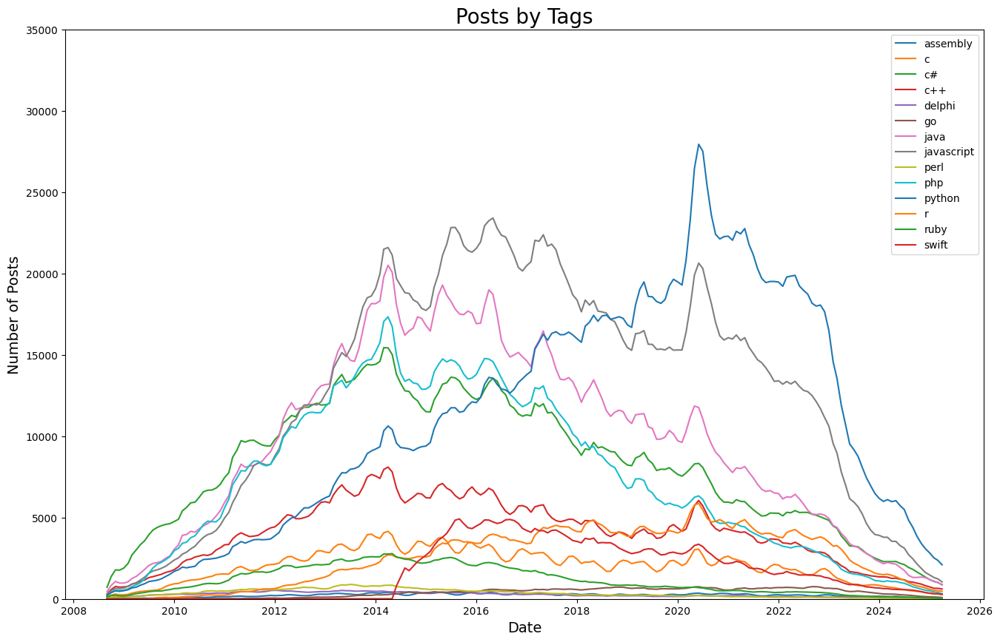

In [108]:
roll_df = reshaped_data.rolling(window=3).mean()
plt.figure(figsize=(16,10)) 
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)
plt.title("Posts by Tags", fontsize=20)
leg_list = []
for column in roll_df.columns:
    plt.plot(roll_df.index, roll_df[column])
    leg_list.append(column)
plt.legend(leg_list)


In [109]:
import matplotlib.animation as animation
from IPython.display import HTML

C:\Users\teamu\AppData\Local\Temp\ipykernel_17572\2276173699.py:15: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.text(x=frame_df.index[-1], y=frame_df[column][-1], s=column, color=color)
Animation size has reached 21025023 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


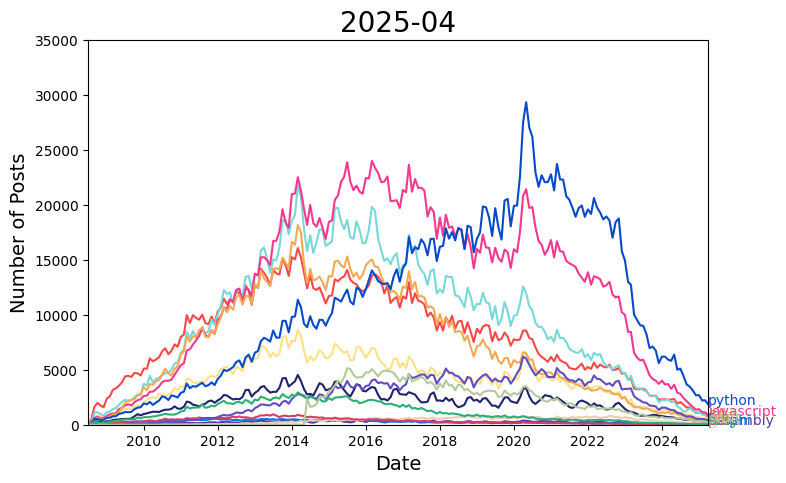

In [112]:
fig, ax = plt.subplots(figsize=(8, 5))
colors = ['#5639A6', '#20236D', '#FA4848', '#FFE087', '#0779E4', '#EECCB4', '#77D8D8', '#F6378F', '#D83C65', '#F3A953', '#064ACB', '#604CC3', '#2AAF74', '#B5C99A']

def draw_frame(frame):
    frame_df = reshaped_data[reshaped_data.index <= frame]
    ax.clear()
    ax.set_xlabel('Date', fontsize=14)
    ax.set_ylabel('Number of Posts', fontsize=14)
    ax.set_ylim(0, 35000)
    ax.set_xlim(reshaped_data.index[0], reshaped_data.index[-1])
    ax.set_title(str(frame).split()[0][:7], fontsize=20)

    for column, color in zip(frame_df.columns, colors):
        ax.plot(frame_df.index, frame_df[column], label=frame_df[column].name, color=color)
        ax.text(x=frame_df.index[-1], y=frame_df[column][-1], s=column, color=color)


ani = animation.FuncAnimation(fig=fig, func=draw_frame, frames=reshaped_data.index)
# draw_frame(reshaped_data.index[19])
HTML(ani.to_jshtml())